## Analyse all

In [ ]:
from pathlib import Path
import os, zipfile, io, contextlib
import pandas as pd
import pymol2, chempy
import plotly.express as px
import functools
import numpy as np
import re
from typing import Dict, List
from collections import defaultdict
from plip.structure.preparation import PDBComplex, PLInteraction

# ---- Babel & atom names ------------
## Mod of https://github.com/matteoferla/PLIP-PyRosetta-hotspots-test/blob/main/plipspots_docking/plipspots/serial.py
# https://github.com/pharmai/plip/blob/1fced62c8aeacfaf41008624579bd241e0a3a271/plip/structure/detection.py
from collections import namedtuple
from typing import Union
from openbabel.pybel import Atom, Residue
from openbabel.pybel import ob


hydroph_interaction = namedtuple('hydroph_interaction', 'bsatom bsatom_orig_idx ligatom ligatom_orig_idx '
                                             'distance restype resnr reschain restype_l, resnr_l, reschain_l')
hbond = namedtuple('hbond', 'a a_orig_idx d d_orig_idx h distance_ah distance_ad angle type protisdon resnr '
                               'restype reschain resnr_l restype_l reschain_l sidechain atype dtype')
pistack = namedtuple(
        'pistack',
        'proteinring ligandring distance angle offset type restype resnr reschain restype_l resnr_l reschain_l')
pication = namedtuple(
        'pication', 'ring charge distance offset type restype resnr reschain restype_l resnr_l reschain_l protcharged')
saltbridge = namedtuple(
        'saltbridge', 'positive negative distance protispos resnr restype reschain resnr_l restype_l reschain_l')
halogenbond = namedtuple('halogenbond', 'acc acc_orig_idx don don_orig_idx distance don_angle acc_angle restype '
                                 'resnr reschain restype_l resnr_l reschain_l donortype acctype sidechain')
waterbridge = namedtuple('waterbridge', 'a a_orig_idx atype d d_orig_idx dtype h water water_orig_idx distance_aw '
                                     'distance_dw d_angle w_angle type resnr restype reschain resnr_l restype_l reschain_l protisdon')
metal_complex = namedtuple('metal_complex', 'metal metal_orig_idx metal_type target target_orig_idx target_type '
                                       'coordination_num distance resnr restype '
                                       'reschain  restype_l reschain_l resnr_l location rms, geometry num_partners complexnum')

itxn_names = ('hydroph_interaction', 'hbond', 'pistack', 'pication', 'saltbridge', 'halogenbond', 'waterbridge', 'metal_complex')
itxn_names = (hydroph_interaction, hbond, pistack, pication, saltbridge, halogenbond, waterbridge, metal_complex)

def isintxn(instance, cls_or_name: Union[type, str]):
    """
    Is ``interaction`` an instance of a class with the same name as ``cls_or_name``?
    """
    if isinstance(cls_or_name, str):
        name: str = cls_or_name
    else:
        name: str = cls_or_name.__name__
    return instance.__class__.__name__ == name

def get_atomname(atom: Union[Atom, ob.OBAtom]) -> str:
    """
    Given an atom, return its name.
    """
    if isinstance(atom, Atom):
        res: ob.OBResidue = atom.residue.OBResidue
        obatom = atom.OBAtom
    elif isinstance(atom, ob.OBAtom):
        obatom: ob.OBAtom = atom
        res: ob.OBResidue = obatom.GetResidue()
    else:
        raise TypeError
    return res.GetAtomID(obatom)

def get_itxn_atomnames(itxn) -> List:
    if isintxn(intxn, 'hydroph_interaction')
        return [get_atomname( intxn.bsatom )]
    elif isintxn(intxn, 'hbond') and itxn.protisdon:
        return [get_atomname( intxn.d )]
    elif isintxn(intxn, 'hbond'):
        return [get_atomname( intxn.a )]
    elif isintxn(intxn, 'pistack'):
        return [get_atomname( a ) for a in intxn.proteinring]
    elif isintxn(intxn, 'pication') and intxn.protcharged
        return [get_atomname( intxn.charge )]
    elif isintxn(intxn, 'pication'):
        return [get_atomname( a ) for a in intxn.ring]
    elif isintxn(intxn, 'saltbridge') and intxn.protispos:
        return [get_atomname( intxn.positive )]
    elif isintxn(intxn, 'saltbridge'):
        return [get_atomname( intxn.negative )]
    elif isintxn(intxn, 'halogenbond'):
        return [get_atomname( intxn.acc )]
    elif isintxn(intxn, 'waterbridge') and intxn.protisdon:
        return [get_atomname( intxn.d )]
    elif isintxn(intxn, 'waterbridge'):
        return [get_atomname( intxn.a )]
    else:
        raise ValueError('metal_complex')

# =================================

def get_lig_info(pdb_block):
    match = re.search(r'HETATM .*LIG (?P<chain>\w)\s*(?P<resi>\d+)', pdb_block)
    return {k: match.group(k) for k in ('chain', 'resi')}


combo = {}


def get_apoblock(zf: zipfile.ZipFile) -> str:
    if len(zf.namelist()) == 0:
        print(target_name, ' is an empty archive')
        raise ValueError('empty archive')
    # get apo bfactors
    if 'reference.pdb' in zf.namelist():
        return zf.read('reference.pdb').decode('utf-8')
    else:
        choices = [n for n in zf.namelist() if '_bound.pdb' in n]
        if len(choices) == 0:
            choices = [n for n in zf.namelist() if '.pdb' in n]
        return zf.read(choices[0]).decode('utf-8')


def get_itxn(filename, zf) -> List:
    if os.path.splitext(filename)[1] != '.pdb' or '_bound.pdb' not in finfo.filename:
        return []
    pdb_block = zf.read(filename).decode('utf-8')
    if 'LIG' not in pdb_block:
        return []
    info: Dict[str, str] = get_lig_info(pdb_block)
    info['xchem_code'] = re.search(r'(\w\d+_\w+)_bound.pdb', finfo.filename).group(1)
    holo = PDBComplex()
    holo.load_pdb(pdb_block, as_string=True)
    holo.analyze()
    return holo.interaction_sets[':'.join(['LIG', info['chain'], info['resi']])].all_itypes


for filepath in Path('fragalysis-downloads').glob('*.zip'):
    target_name = os.path.splitext(os.path.split(filepath)[1])[0]
    try:
        with open(filepath, 'rb') as fh:
            zf = zipfile.ZipFile(fh, "r")
            # -----------------------------------
            # ## Analysis of Apo
            apoblock: str = get_apoblock(zf)
            with pymol2.PyMOL() as pymol:
                pymol.cmd.read_pdbstr(apoblock, 'apo')
                # ligand: no
                pymol.cmd.remove('organic')
                bfactors = defaultdict(list)
                cabfactors = {(a.chain, a.resi): a.b for a in pymol.cmd.get_model('apo').atom if a.name == 'CA'}
                pymol.cmd.set('dot_solvent', 1)
                pymol.cmd.set('dot_density', 3)
                get_sele = lambda chain, resi: f'resi {resi} and chain {chain}' if chain else f'resi {resi}'
                sasas = {(chain, resi): pymol.cmd.get_area(get_sele(chain, resi)) for chain, resi in cabfactors}
            # normalise
            # original
            l = np.array(functools.reduce(lambda x, y: [*x, *y], bfactors.values(), []))
            med = np.median(l)
            mad = np.median(np.abs(l - med)) * 1.4826
            zbfactors = {k: np.median((v - med) / mad) for k, v in bfactors.items()}
            # mod use CA only
            l = np.array(list(cabfactors.values()))
            med = np.median(l)
            mad = np.median(np.abs(l - med)) * 1.4826
            zcabfactors = {k: (v - med) / mad for k, v in cabfactors.items()}
            # -----------------------------------
            # ## Count
            counts = {k: defaultdict(int) for k in (
                'hydroph_interaction', 'hbond', 'pistack', 'waterbridge', 'saltbridge', 'pication', 'halogenbond')}
            n_hits = 0
            for finfo in zf.infolist():
                intxns: List = get_itxn(finfo.filename, zf)
                if not intxns:
                    continue
                n_hits += 1
                for intxn in intxns:
                    counts[intxn.__class__.__name__][(intxn.reschain, str(intxn.resnr))] += 1
            # ratio
            hit_rates = defaultdict(int)
            split_hit_rates = {intxn_type: defaultdict(int) for intxn_type in counts}
            for intxn_type in counts:
                for k in counts[intxn_type]:
                    split_hit_rates[intxn_type][k] = counts[intxn_type][k] / n_hits
                    hit_rates[k] += counts[intxn_type][k] / n_hits
        # << zip closed.
        # -----------------------------------
        # ## Save
        data = pd.DataFrame({'bfactor_median': zbfactors,
                             'bfactor_CA': zcabfactors,
                             'sasa': sasas,
                             # 'bfactor': bfactors, # this is a per-atom list
                             #'ca_bfactor': cabfactors,
                             'hit_rate': hit_rates,
                             **split_hit_rates})
        combo[target_name] = data
        print(f'{target_name} done')
    except Exception as error:
        print(f'{target_name} error: {error.__class__.__name__}={error}')

print('DONE', len(combo))

In [12]:
print('DONE', len(combo))
combo.keys()

DONE 41


dict_keys(['NUDT7A', 'Nprot', 'NSP15_B', 'CAMK1DA', 'INPP5DA', 'NSP14', 'SOS3ATA', 'EPB41L3A', 'PHIPA', 'ATAD2A', 'MID2A', 'mArh', 'FAM83BA', 'nsp13', 'TNCA', 'Mac1', 'NUDT7A_CRUDE', 'SMTGR', 'NUDT21A', 'MUREECA', 'MURD', 'ATAD', 'NUDT4', 'PTP1B', 'CD44MMA', 'OXA10OTA', 'PARP14A', 'FALZA', 'ACVR1A', 'DCP2B', 'HAO1A', 'NUDT5A', 'BRD1A', 'STAG1A', 'smTGRNEW', 'macro-combi', 'DCLRE1AA', 'VIM2', 'TBXTA', 'XX02KALRNA', 'NUDT4A'])

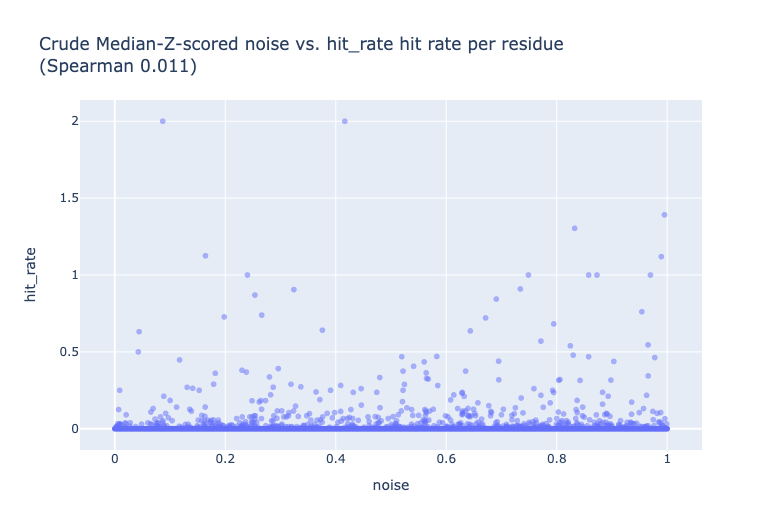

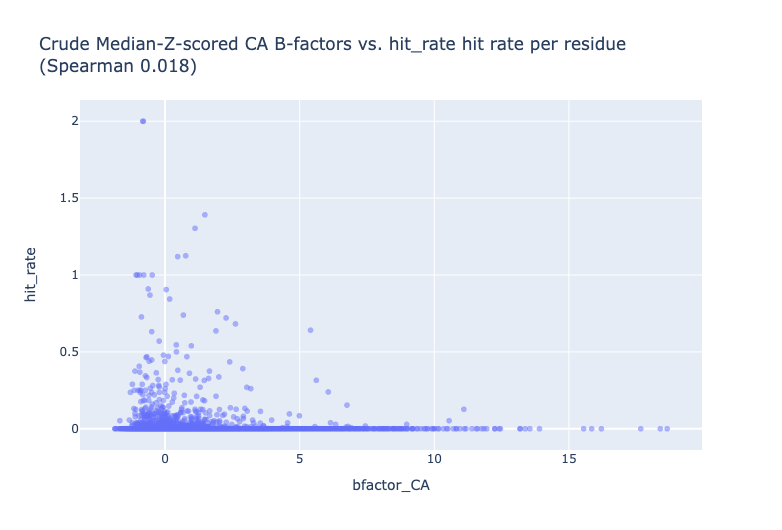

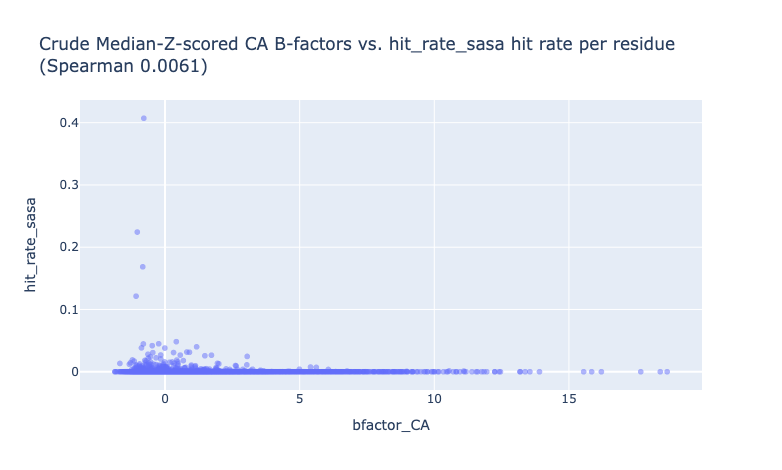

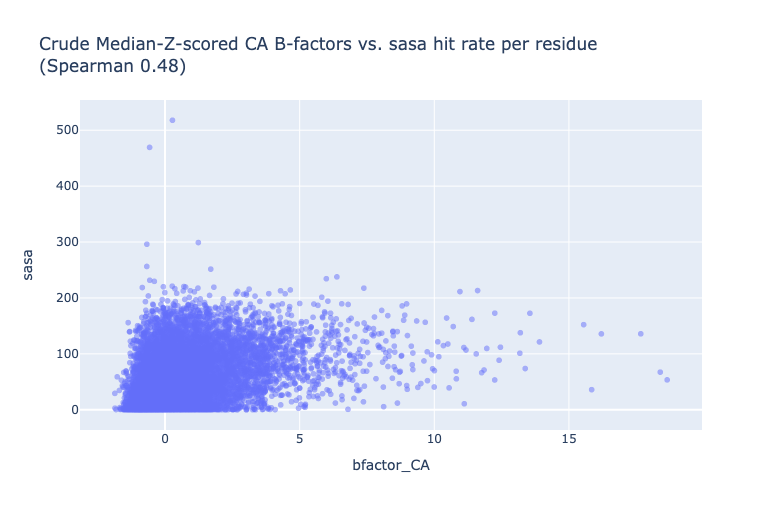

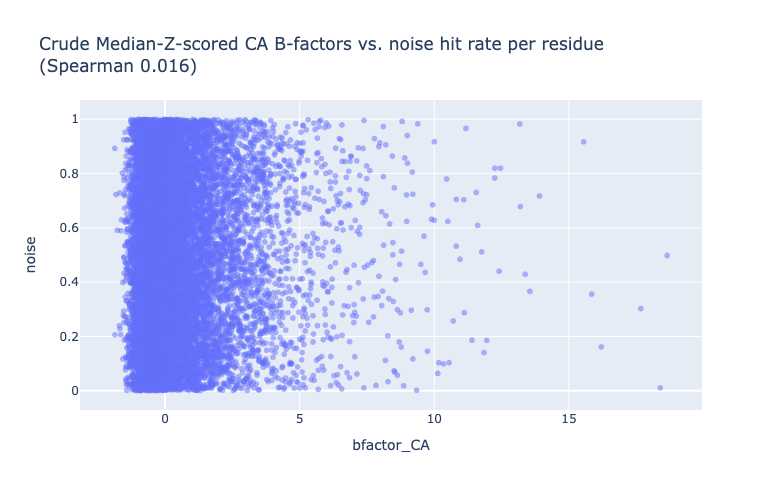

...

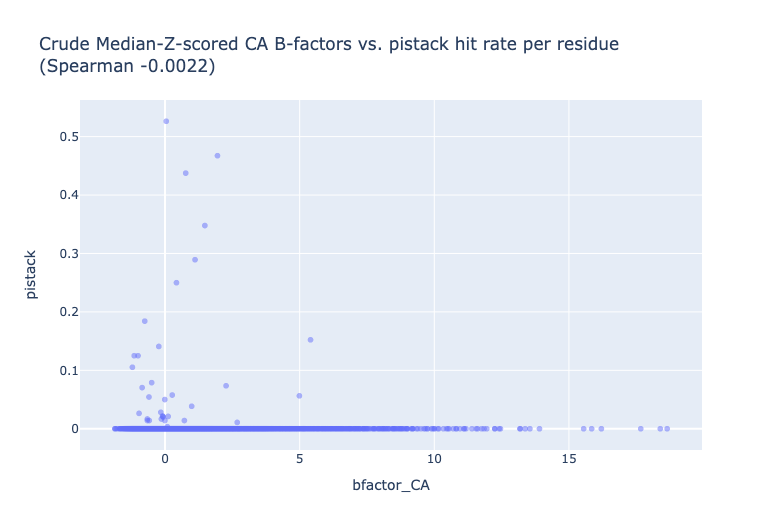

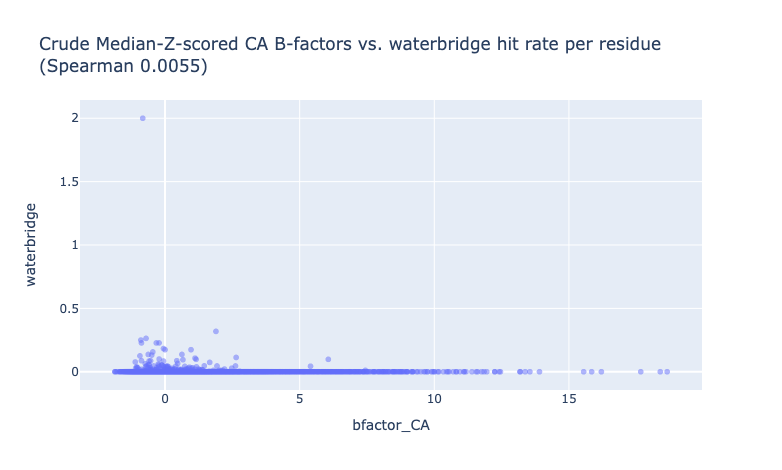

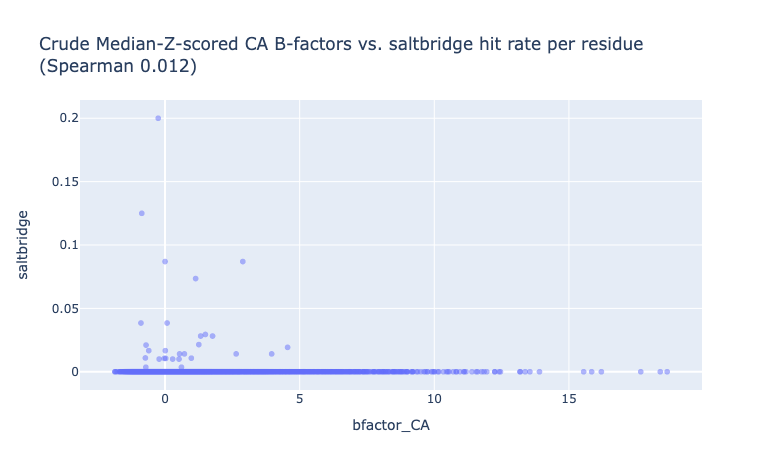

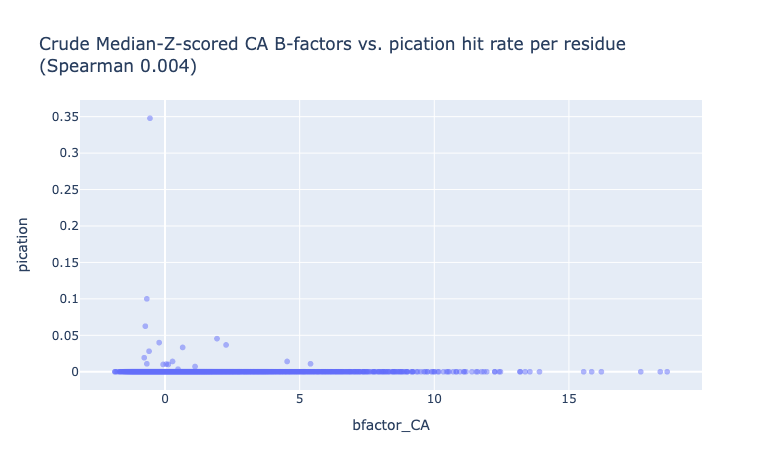

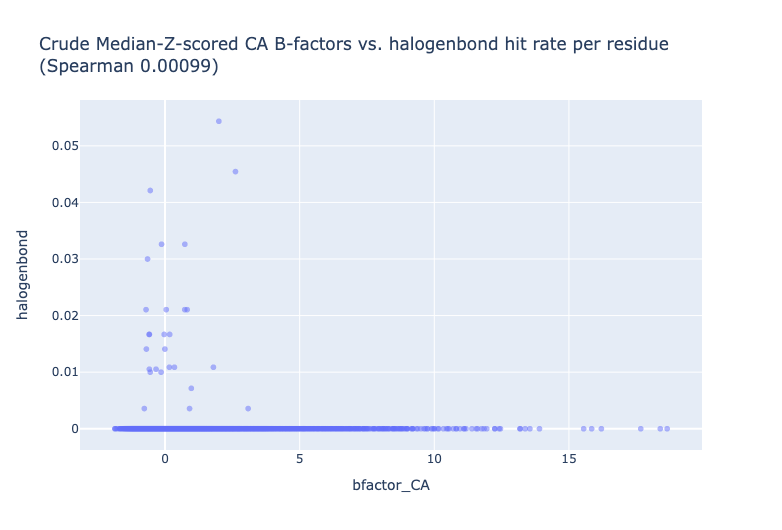

In [53]:
import plotly.express as px
import operator, random

data = pd.concat(list(combo.values()))
data = data.loc[~data.bfactor_CA.isna()].copy().fillna(0)
data['hit_rate_sasa'] = data.hit_rate / data.sasa
data['noise'] = data.hit_rate_sasa.apply(lambda row: random.random() )

j = 'noise'
k = 'hit_rate'
spear = data[j].corr(data[k], method='spearman')
px.scatter(data, j, k,
               opacity=0.5,
               title=f'Crude Median-Z-scored {j} vs. {k} hit rate per residue<br>(Spearman {spear:.2})').show()

for k in ('hit_rate', 'hit_rate_sasa', 'sasa', 'noise', 'hydroph_interaction', 'hbond', 'pistack', 'waterbridge', 'saltbridge', 'pication', 'halogenbond'):
    spear = data.bfactor_CA.corr(data[k], method='spearman')
    px.scatter(data, 'bfactor_CA', k,
               opacity=0.5,
               title=f'Crude Median-Z-scored CA B-factors vs. {k} hit rate per residue<br>(Spearman {spear:.2})').show()

In [58]:
data

bfactor_median  bfactor_CA        sasa  ca_bfactor  hit_rate  \
A 15              0.0    2.713807   94.243706   59.299999       0.0   
  16              0.0    2.558764   74.956177   57.930000       0.0   
  17              0.0    2.518023   68.257675   57.570000       0.0   
  18              0.0    2.546316   90.181107   57.820000       0.0   
  19              0.0    2.421829   87.116798   56.720001       0.0   
...               ...         ...         ...         ...       ...   
B 141             0.0    1.009662   87.416420   64.860001       0.0   
  142             0.0    1.262700  135.904266   67.910004       0.0   
  143             0.0    1.416182   41.979984   69.760002       0.0   
  144             0.0    2.583474  112.413544   83.830002       0.0   
  145             0.0    3.018201  208.371246   89.070000       0.0   

       hydroph_interaction  hbond  pistack  waterbridge  saltbridge  pication  \
A 15                   0.0    0.0      0.0          0.0         0.0       0.0   
  16                   0.0    0.0      0.0          0.0         0.0       0.0   
  17                   0.0    0.0      0.0          0.0         0.0       0.0   
  18                   0.0    0.0      0.0          0.0         0.0       0.0   
  19                   0.0    0.0      0.0          0.0         0.0       0.0   
...                    ...    ...      ...          ...         ...       ...   
B 141                  0.0    0.0      0.0          0.0         0.0       0.0   
  142                  0.0    0.0      0.0          0.0         0.0       0.0   
  143                  0.0    0.0      0.0          0.0         0.0       0.0   
  144                  0.0    0.0      0.0          0.0         0.0       0.0   
  145                  0.0    0.0      0.0          0.0         0.0       0.0   

       halogenbond  hit_rate_sasa     noise  bfactor_CA_sasa  
A 15           0.0            0.0  0.938399         0.028796  
  16           0.0            0.0  0.471420         0.034137  
  17           0.0            0.0  0.426752         0.036890  
  18           0.0            0.0  0.023909         0.028236  
  19           0.0            0.0  0.139933         0.027800  
...            ...            ...       ...              ...  
B 141          0.0            0.0  0.811475         0.011550  
  142          0.0            0.0  0.911166         0.009291  
  143          0.0            0.0  0.902380         0.033735  
  144          0.0            0.0  0.769501         0.022982  
  145          0.0            0.0  0.402745         0.014485  

[14357 rows x 15 columns]

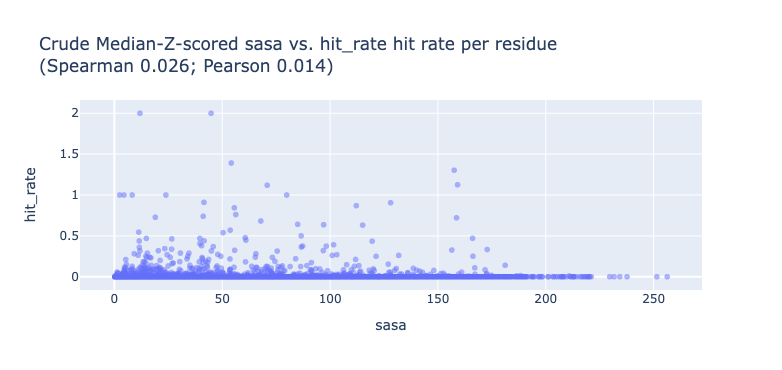

In [78]:
data = data.loc[(data.sasa <= 264) & (data.sasa > 0.2)].copy()
data['hit_rate_sasa'] = data.hit_rate / data.sasa
data['bfactor_CA_sasa'] = data.bfactor_CA / data.sasa

j = 'sasa'
k = 'hit_rate'
spear = data[j].corr(data[k], method='spearman')
pear = data[j].corr(data[k], method='pearson')
px.scatter(data, j, k,
               opacity=0.5,
               title=f'Crude Median-Z-scored {j} vs. {k} hit rate per residue<br>'+\
                     f'(Spearman {spear:.2}; Pearson {pear:.2})').show()


## Metadata precense?

In [6]:
from pathlib import Path
import os, zipfile, io
import pandas as pd

statuses = []
for filepath in Path('fragalysis-downloads').glob('*.zip'):
    target_name = os.path.splitext( os.path.split(filepath)[1] )[0]
    status = dict(name=target_name, filepath=filepath)
    with open(filepath, 'rb') as fh:
        zf = zipfile.ZipFile(fh, "r")
        for item in ('metadata', 'reference', 'combined'):
            for fileinfo in zf.infolist():
                if item in fileinfo.filename:
                    status[item] = True
                    break
            else:
                status[item] = False
        statuses.append(status)
        
status = pd.DataFrame(statuses)

In [8]:
status.loc[status.reference & status.metadata]

,name,filepath,metadata,reference,combined
7,NSP14,fragalysis-downloads/NSP14.zip,True,True,False
8,SOS3ATA,fragalysis-downloads/SOS3ATA.zip,True,True,False
12,MID2A,fragalysis-downloads/MID2A.zip,True,True,False
17,Mac1,fragalysis-downloads/Mac1.zip,True,True,False
33,Mpro,fragalysis-downloads/Mpro.zip,True,True,False
40,macro-combi,fragalysis-downloads/macro-combi.zip,True,True,False


## Get B-factors per CA — old

{'ALA', 'PHE', 'GLU', 'HIS', 'SER', 'LEU', 'GLY', 'FMT', 'GLN', 'LYS', 'CYS', 'ASP', 'LIG', 'ASN', 'MET', 'VAL', 'HOH', 'ILE', 'THR', 'ARG', 'PRO', 'TYR', 'TRP'}


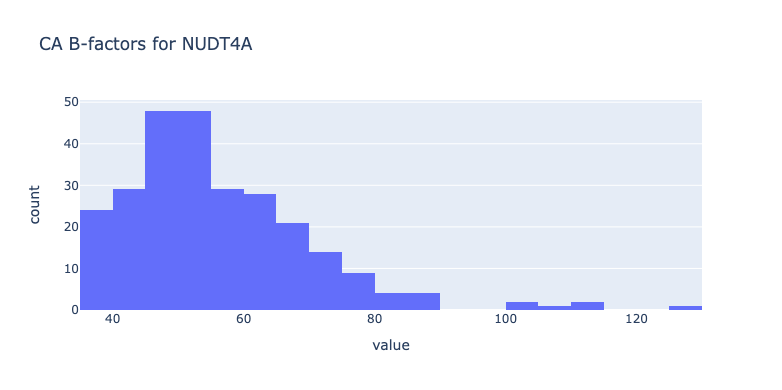

In [16]:
import pymol2, chempy
import plotly.express as px

#apoblock = zf.read('reference.pdb')
with pymol2.PyMOL() as pymol:
    pymol.cmd.read_pdbstr(apoblock, 'apo')
    print( {a.resn for a in pymol.cmd.get_model('apo').atom} )
    cabfactors = [a.b for a in pymol.cmd.get_model('apo').atom if a.name == 'CA']
    
fig = px.histogram(cabfactors, title=f'CA B-factors for {target_name}')
fig.update_traces(showlegend=False)
fig

## Get B-factors per CA & total

In [2]:
import pymol2, chempy
import plotly.express as px
import functools
import numpy as np

with pymol2.PyMOL() as pymol:
    pymol.cmd.read_pdbstr(apoblock, 'apo')
    bfactors = defaultdict(list)
    for a in pymol.cmd.get_model('apo').atom:
        bfactors[(a.chain, a.resi)].append(a.b)
    cabfactors = {(a.chain, a.resi): a.b for a in pymol.cmd.get_model('apo').atom if a.name == 'CA'}
    pymol.cmd.set('dot_solvent', 1)
    pymol.cmd.set('dot_density', 3)
    sasas = {(a.chain, a.resi): pymol.cmd.get_area(f'resi {resi} and chain {chain}' if chain else f'resi {resi}')
                        for chain, resi in bfactors.keys()}
    
l = np.array(functools.reduce(lambda x, y: [*x, *y], bfactors.values(), []))
np.mean(l), np.median(l), np.std(l), np.median(np.abs(l - np.median(l))) * 1.4826

NameError: name 'apoblock' is not defined

It's a skew normal, median z-score will not fix the tails.
In futher iteration, Box-Cox transformation?

In [210]:
l = np.array(functools.reduce(lambda x, y: [*x, *y], bfactors.values(), []))

med = np.median(l)
mad = np.median(np.abs(l - med)) * 1.4826
zbfactors = {k: np.median((v - med) / mad) for k, v in bfactors.items()}

In [ ]:
## PLIP

In [229]:
from gist_import import GistImporter
faux_module = GistImporter.from_github('https://raw.githubusercontent.com/matteoferla/Fragment-hit-follow-up-chemistry/main/followup/plip.py')
SerialPLIPper = faux_module['SerialPLIPper']


import re
from typing import Dict, List
from collections import defaultdict
from plip.structure.preparation import PDBComplex, PLInteraction

def get_lig_info(pdb_block):
    match = re.search(r'HETATM .*LIG (?P<chain>\w)\s*(?P<resi>\d+)', pdb_block)
    return {k: match.group(k) for k in ('chain', 'resi')}

In [173]:
counts = {k: defaultdict(int) for k in ('hydroph_interaction', 'hbond', 'pistack', 'waterbridge', 'saltbridge', 'pication', 'halogenbond')}

n_hits = 0
for finfo in zf.infolist():
    if os.path.splitext(finfo.filename)[1] == '.pdb' and '_bound.pdb' in finfo.filename:
        n_hits += 1
        pdb_block = zf.read(finfo.filename).decode('utf-8')
        info: Dict[str, str] = get_lig_info(pdb_block)
        info['xchem_code'] = re.search(r'(x\d+_\w+)_bound.pdb', finfo.filename).group(1)
        holo = PDBComplex()
        holo.load_pdb(pdb_block, as_string=True)
        holo.analyze()
        intxns: List = holo.interaction_sets[':'.join(['LIG', info['chain'], info['resi']])].all_itypes
        intxn_dex = defaultdict(int)
        for intxn in intxns:
            counts[intxn.__class__.__name__][(intxn.reschain, str(intxn.resnr))] += 1 

In [182]:
hit_rates = defaultdict(int)
split_hit_rates = {intxn_type: defaultdict(int) for intxn_type in counts}

for intxn_type in counts:
    for k in counts[intxn_type]:
        split_hit_rates[intxn_type][k] = counts[intxn_type][k]/n_hits
        hit_rates[k] += counts[intxn_type][k]/n_hits

In [211]:
# original

l = np.array(functools.reduce(lambda x, y: [*x, *y], bfactors.values(), []))

med = np.median(l)
mad = np.median(np.abs(l - med)) * 1.4826
zbfactors = {k: np.median((v - med) / mad) for k, v in bfactors.items()}

# mod use CA only
l = np.array(list(cabfactors.values()))
med = np.median(l)
mad = np.median(np.abs(l - med)) * 1.4826
zcabfactors = {k: (v - med) / mad for k, v in cabfactors.items()}

In [214]:
data = pd.DataFrame({'bfactor_median': zbfactors, 'bfactor_CA': zcabfactors, 'hit_rate': hit_rates, **split_hit_rates})
data 

bfactor_median  bfactor_CA  hit_rate  hydroph_interaction  hbond  \
D 24         6.763940    8.805515       NaN                  NaN    NaN   
  25         6.328555    8.184074       NaN                  NaN    NaN   
  26         7.080963    6.682006       NaN                  NaN    NaN   
  27         0.799991    1.404305       NaN                  NaN    NaN   
  28        -0.239700    0.073512       NaN                  NaN    NaN   
...               ...         ...       ...                  ...    ...   
S 430        8.459089         NaN       NaN                  NaN    NaN   
  431       -0.818430         NaN       NaN                  NaN    NaN   
D 372             NaN         NaN  0.027397             0.027397    NaN   
  459             NaN         NaN  0.013699             0.013699    NaN   
  373             NaN         NaN  0.013699             0.013699    NaN   

       pistack  waterbridge  saltbridge  pication  halogenbond  
D 24       NaN          NaN         NaN       NaN          NaN  
  25       NaN          NaN         NaN       NaN          NaN  
  26       NaN          NaN         NaN       NaN          NaN  
  27       NaN          NaN         NaN       NaN          NaN  
  28       NaN          NaN         NaN       NaN          NaN  
...        ...          ...         ...       ...          ...  
S 430      NaN          NaN         NaN       NaN          NaN  
  431      NaN          NaN         NaN       NaN          NaN  
D 372      NaN          NaN         NaN       NaN          NaN  
  459      NaN          NaN         NaN       NaN          NaN  
  373      NaN          NaN         NaN       NaN          NaN  

[884 rows x 10 columns]

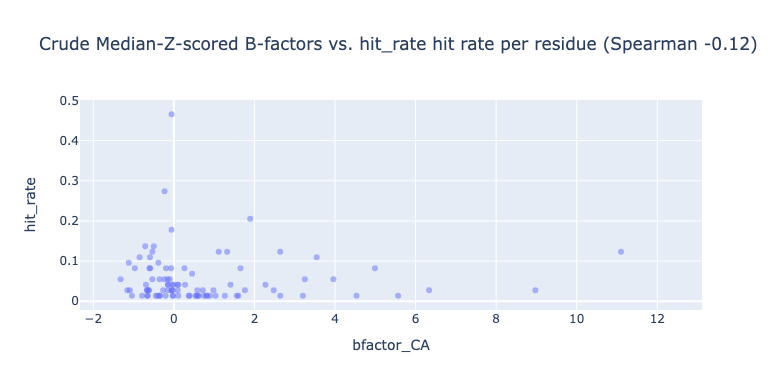

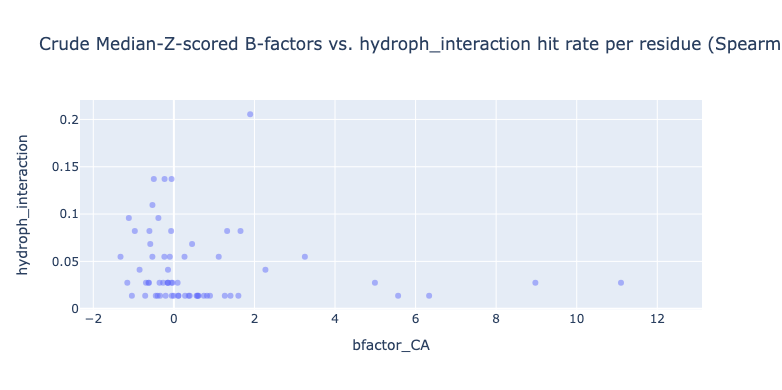

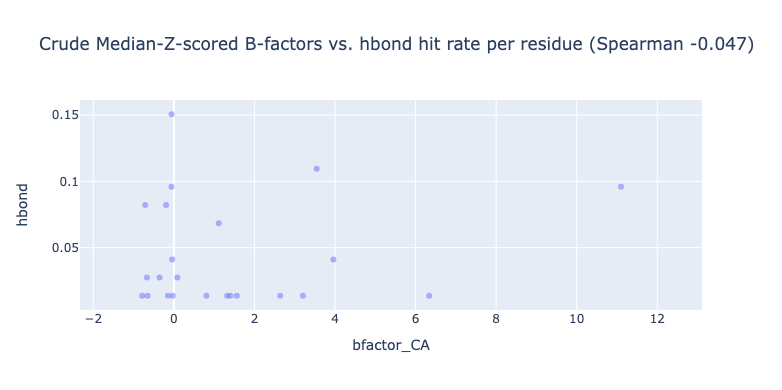

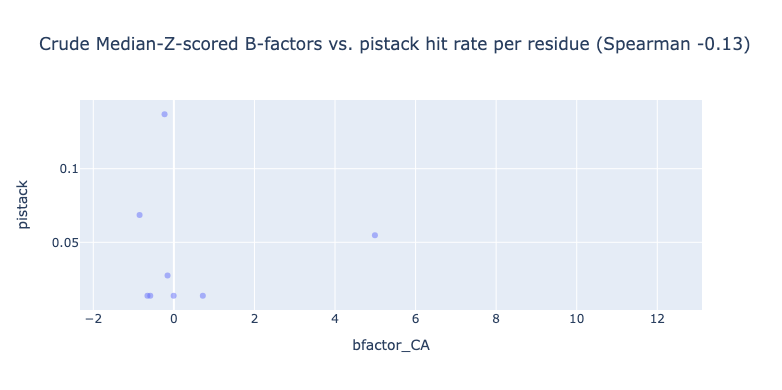

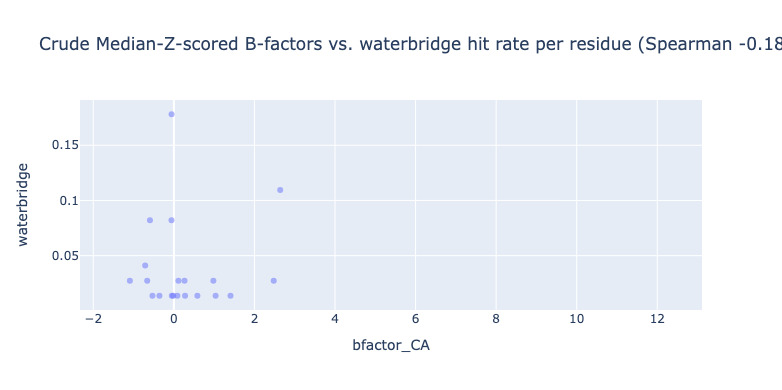

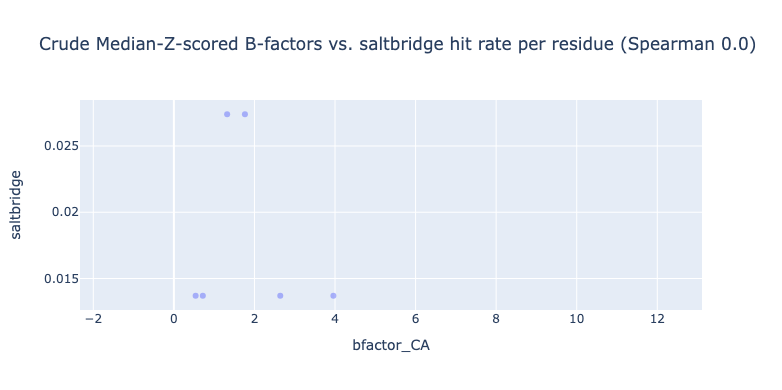

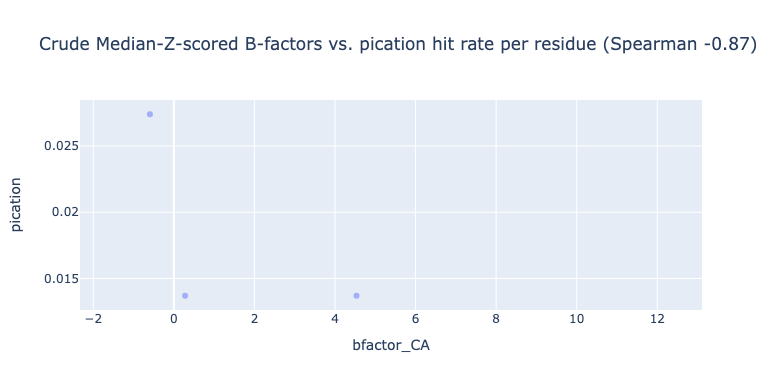

/Users/user/.conda/envs/py310/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



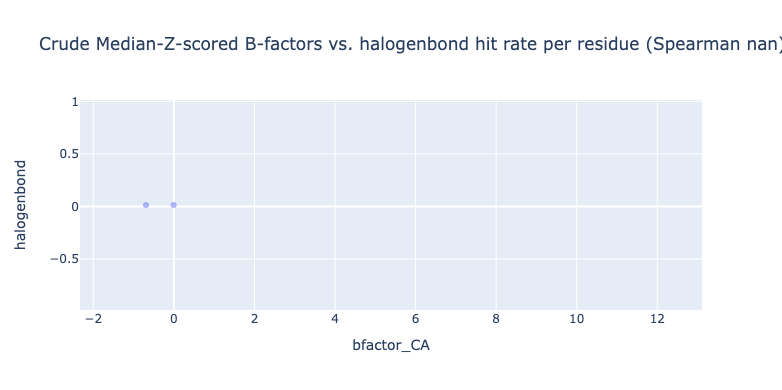

In [218]:
import plotly.express as px

for k in ('hit_rate', 'hydroph_interaction', 'hbond', 'pistack', 'waterbridge', 'saltbridge', 'pication', 'halogenbond'):
    spear = data.bfactor_CA.corr(data[k], method='spearman')
    px.scatter(data, 'bfactor_CA', k,
               opacity=0.5,
               title=f'Crude Median-Z-scored B-factors vs. {k} hit rate per residue (Spearman {spear:.2})').show()

## All

In [6]:
len(combo)

41

In [44]:
d = 4

for filepath in Path('fragalysis-downloads').glob('*.zip'):
    target_name = os.path.splitext( os.path.split(filepath)[1] )[0]
    if target_name not in combo:
        continue
    with open(filepath, 'rb') as fh:
        zf = zipfile.ZipFile(fh, "r")
        if len(zf.namelist()) == 0:
            print(target_name, ' is an empty archive' )
            continue
        # get apo bfactors
        filename = 'reference.pdb'
        if filename in zf.namelist():
            apoblock = zf.read(filename)
        else:
            choices = [n for n in zf.namelist() if '_bound.pdb' in n]
            if len(choices) == 0:
                choices = [n for n in zf.namelist() if '.pdb' in n]
            filename = choices[0]
            apoblock = zf.read( choices[0] )
        water_tally = dict()
        with pymol2.PyMOL() as pymol:
            pymol.cmd.read_pdbstr(apoblock, 'apo')
            residues = {(a.chain, a.resi) for a in pymol.cmd.get_model('apo').atom if a.name == 'CA'}
            for chain, resi in residues:
                if chain:
                    sele = f'resi {resi} and chain {chain}'
                else:
                    sele = f'resi {resi}'
                water_tally[(chain, resi)] = pymol.cmd.select(f"resn HOH and (byres ({sele}) around {d})")
                # if water_tally[(chain, resi)] > 5:
                #     print(target_name, filename, chain, resi, water_tally[(chain, resi)])
            combo[target_name]['water_tally'] = water_tally
            combo[target_name]['water_tally'] = combo[target_name]['water_tally'].fillna(0)

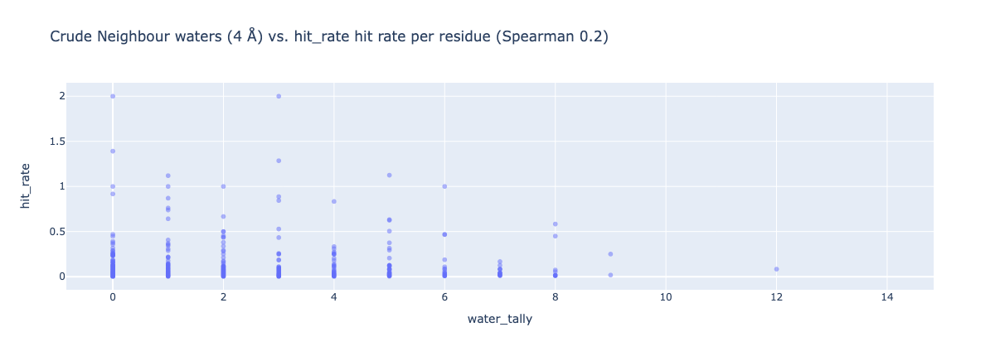

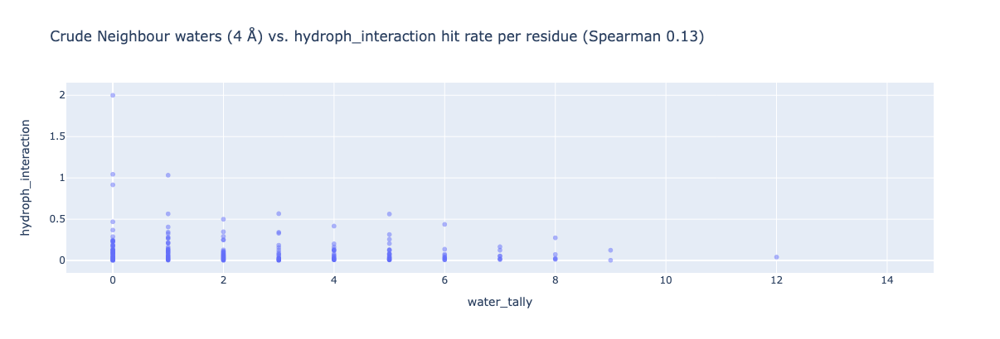

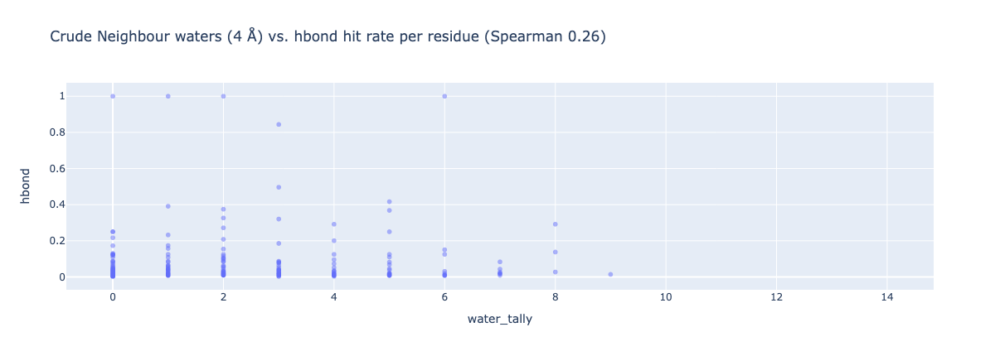

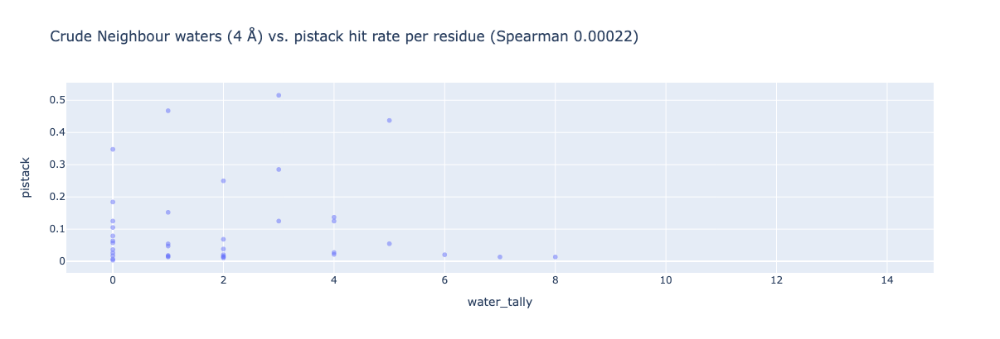

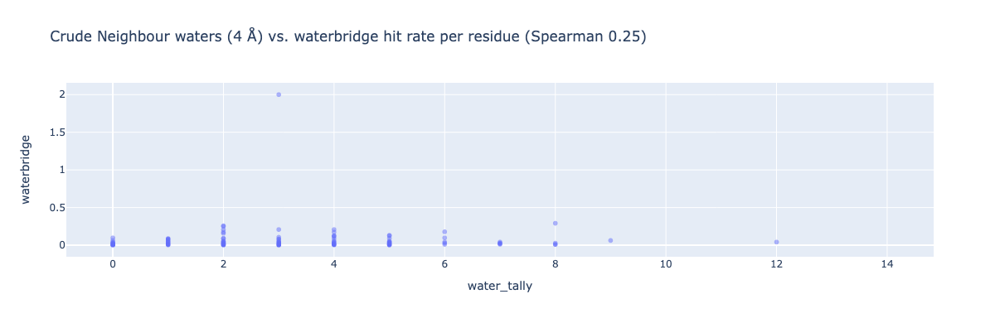

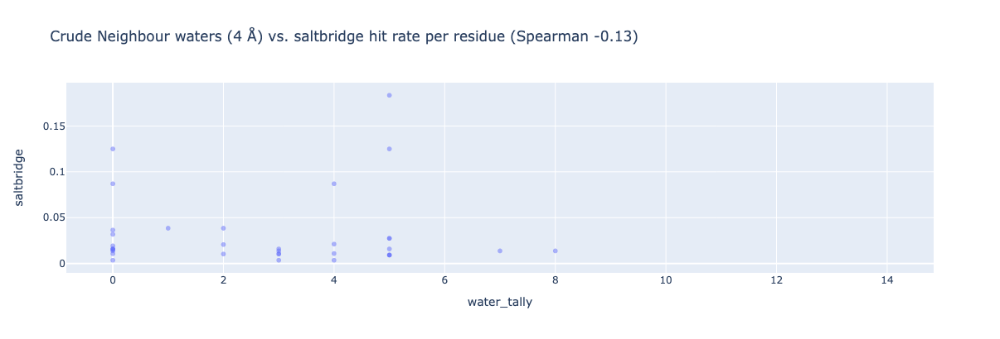

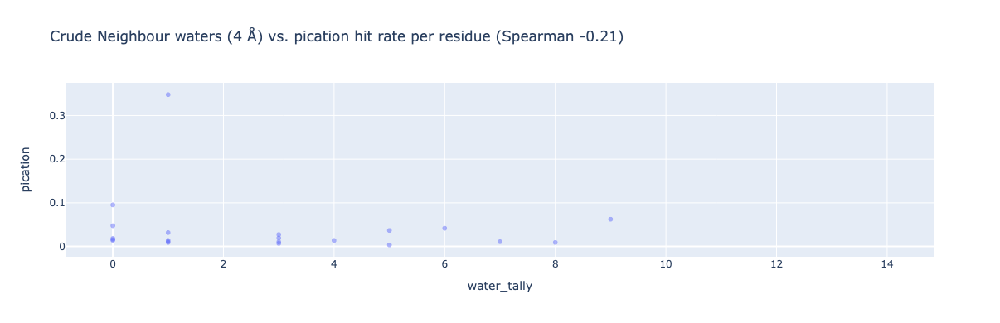

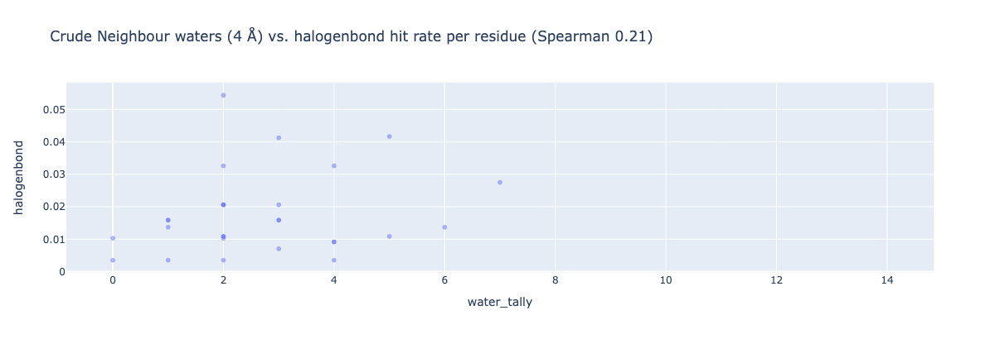

In [50]:
data = pd.concat(list(combo.values()))
for k in ('hit_rate', 'hydroph_interaction', 'hbond', 'pistack', 'waterbridge', 'saltbridge', 'pication', 'halogenbond'):
    spear = data.water_tally.corr(data[k], method='spearman')
    px.scatter(data, 'water_tally', k,
               opacity=0.5,
               title=f'Crude Neighbour waters ({d} Å) vs. {k} hit rate per residue (Spearman {spear:.2})').show()

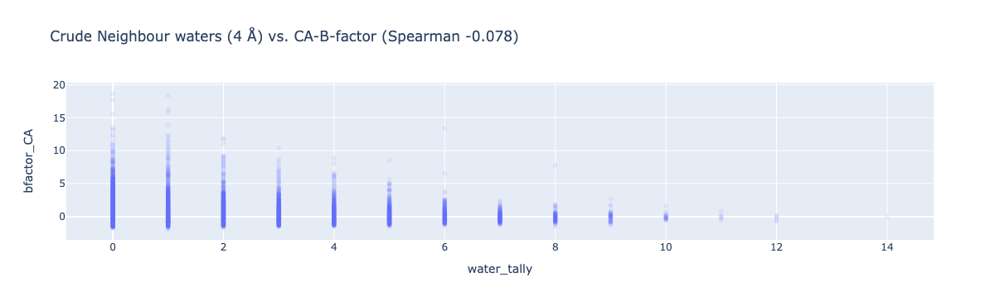

In [58]:
data = pd.concat(list(combo.values()))
k = 'bfactor_CA'
spear = data.water_tally.corr(data[k], method='spearman')
px.scatter(data, 'water_tally', k,
       opacity=0.1,
       title=f'Crude Neighbour waters ({d} Å) vs. CA-B-factor (Spearman {spear:.2})').show()

In [131]:


for datum in data:
    for k in datum.keys():
        if not isinstance(k, tuple):
            continue
        k[
    datum['chain'], datum['resi']
print(data)

[{'chain': 'D', 'resi': '1201', 'xchem_code': 'x1375_0D', ('hydroph_interaction', 'ILE', 42): 1, ('hydroph_interaction', 'ILE', 45): 1, ('hydroph_interaction', 'LEU', 54): 1, ('hydroph_interaction', 'THR', 193): 1}, {'chain': 'D', 'resi': '1132', 'xchem_code': 'x1245_0D', ('hydroph_interaction', 'ASN', 334): 1, ('hydroph_interaction', 'PRO', 355): 1, ('hbond', 'ASN', 386): 1, ('hydroph_interaction', 'ASN', 386): 1, ('hbond', 'ASN', 388): 1, ('hydroph_interaction', 'PHE', 426): 1, ('hbond', 'THR', 428): 2}, {'chain': 'D', 'resi': '1201', 'xchem_code': 'x1641_0D', ('hbond', 'ASN', 306): 1, ('waterbridge', 'ASN', 386): 1, ('hydroph_interaction', 'PHE', 401): 1, ('pistack', 'TYR', 420): 1, ('hydroph_interaction', 'ASN', 422): 1, ('hydroph_interaction', 'PHE', 426): 1, ('hydroph_interaction', 'PHE', 506): 1}, {'chain': 'D', 'resi': '1201', 'xchem_code': 'x1412_0D', ('hydroph_interaction', 'ASN', 334): 1, ('hydroph_interaction', 'PRO', 355): 1, ('hbond', 'ASN', 386): 1, ('hydroph_interaction

In [96]:
from typing import Union
from openbabel.pybel import Atom, Residue
from openbabel.pybel import ob

def get_atomname(atom: Union[Atom, ob.OBAtom]) -> str:
    """
    Given an atom, return its name.
    """
    if isinstance(atom, Atom):
        res: ob.OBResidue = atom.residue.OBResidue
        obatom = atom.OBAtom
    elif isinstance(atom, ob.OBAtom):
        obatom: ob.OBAtom = atom
        res: ob.OBResidue = obatom.GetResidue()
    else:
        raise TypeError
    return res.GetAtomID(obatom)

def get_atom_by_atomname(residue: Union[ob.OBResidue, Residue], atomname: str) -> ob.OBAtom:
    """
    Get an atom by its name in a residue.
    """
    if isinstance(residue, Residue):
        residue = residue.OBResidue
    obatom: ob.OBAtom
    for obatom in ob.OBResidueAtomIter(residue):
        if residue.GetAtomID(obatom).strip() == atomname:
            return obatom
    else:
        raise ValueError(f'No atom with name {atomname} in residue {residue.GetName()}')


In [95]:
from typing import Sequence, Any

def summarize_interaction(intxn, atom_names: Sequence[str]) -> Dict[str, Any]:
    # https://github.com/openbabel/openbabel/blob/master/data/atomtyp.txt
    # https://blog.matteoferla.com/2023/07/a-note-no-plip-interactions.html
    relevant_atom_names = []
    type_name = intxn.__class__.__name__
    details = {'type': type_name, 'protein_resn': intxn.restype, 'protein_resi': intxn.resnr,
               'protein_chain': intxn.reschain}
    if type_name == 'hbond':
        if intxn.protisdon:
            # assert hbond.a.residue.name != self.resn
            details['atom_names'] = [atom_names[intxn.a.idx - 1]]
            details['type'] = 'hbond_acceptor'
            details['babel_atom_types'] = [intxn.atype]
        else:
            details['atom_names'] = [atom_names[intxn.d.idx - 1]]
            details['type'] = 'hbond_donor'
            details['babel_atom_types'] = [intxn.dtype]
        details['distance'] = intxn.distance_ad  # intxn.distance_ad is to donor, _ah to hydrogen
    elif type_name == 'hydroph_interaction':
        details['atom_names'] = [atom_names[intxn.ligatom.idx - 1]]
        details['babel_atom_types'] = [intxn.ligatom.type]
        details['distance'] = intxn.distance
    elif type_name == 'pistack':
        details['atom_names'] = [atom_names[a.idx - 1] for a in intxn.ligandring.atoms]
        details['babel_atom_types'] = [a.type for a in intxn.ligandring.atoms]
        details['distance'] = intxn.distance
    elif type_name == 'waterbridge':
        if intxn.protisdon:
            # assert hbond.a.residue.name != self.resn
            details['atom_names'] = [atom_names[intxn.a.idx - 1]]
            details['type'] = 'water_acceptor'
            details['babel_atom_types'] = [intxn.atype]
            details['distance'] = intxn.distance_aw
        else:
            details['atom_names'] = [atom_names[intxn.d.idx - 1]]
            details['type'] = 'water_donor'
            details['babel_atom_types'] = [intxn.dtype]
            details['distance'] = intxn.distance_dw
    elif type_name == 'saltbridge':
        if intxn.protispos:
            details['atom_names'] = [atom_names[a.idx - 1] for a in intxn.negative.atoms]
            details['type'] = 'saltbridge_negative'
            details['babel_atom_types'] = [a.type for a in intxn.negative.atoms]
            details['distance'] = intxn.distance
        else:
            details['atom_names'] = [atom_names[a.idx - 1] for a in intxn.positive.atoms]
            details['type'] = 'saltbridge_positive'
            details['babel_atom_types'] = [a.type for a in intxn.positive.atoms]
            details['distance'] = intxn.distance
    elif type_name == 'pication':
        if intxn.protcharged:
            details['atom_names'] = [atom_names[a.idx - 1] for a in intxn.ring.atoms]
            details['type'] = 'pication_ring'
            details['babel_atom_types'] = [a.type for a in intxn.ring.atoms]
            details['distance'] = intxn.distance
        else:
            details['atom_names'] = [atom_names[a.idx - 1] for a in intxn.charge.atoms]
            details['type'] = 'pication_charge'
            details['babel_atom_types'] = [a.type for a in intxn.charge.atoms]
            details['distance'] = intxn.distance
    elif type_name == 'halogenbond':
        details['atom_names'] = [atom_names[intxn.don.idx - 1]]
        details['babel_atom_types'] = [intxn.don.type]
        details['distance'] = intxn.distance
    else:  # metal_complex basically.
        raise TypeError(type_name)
    return details

'reference.pdb'

In [ ]:
SerialPLIPper